In [1]:
import sys
import types
import pandas as pd
from botocore.client import Config
import ibm_boto3
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import random
from sklearn import datasets, linear_model
from sklearn.linear_model import LogisticRegression
from sklearn.cross_validation import train_test_split


def __iter__(self): return 0

# @hidden_cell
# The following code accesses a file in your IBM Cloud Object Storage. It includes your credentials.
# You might want to remove those credentials before you share your notebook.
client_4f7a6e0ff9dc4919a8c34923cea6ed22 = ibm_boto3.client(service_name='s3',
    ibm_api_key_id='aVy5uLkU9PeK5C4X5xHgkDWrBfxbQ_3vFTghIzoCSj7V',
    ibm_auth_endpoint="https://iam.ng.bluemix.net/oidc/token",
    config=Config(signature_version='oauth'),
    endpoint_url='https://s3-api.us-geo.objectstorage.service.networklayer.com')

body = client_4f7a6e0ff9dc4919a8c34923cea6ed22.get_object(Bucket='ist718groupproject-donotdelete-pr-kkxwqqaibaz2pf',Key='ks-projects-201801.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df_data_1 = pd.read_csv(body)
df_data_1.head()

/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/sklearn/cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
0,1000002330,The Songs of Adelaide & Abullah,Poetry,Publishing,GBP,2015-10-09,1000.0,2015-08-11 12:12:28,0.0,failed,0,GB,0.0,0.0,1533.95
1,1000003930,Greeting From Earth: ZGAC Arts Capsule For ET,Narrative Film,Film & Video,USD,2017-11-01,30000.0,2017-09-02 04:43:57,2421.0,failed,15,US,100.0,2421.0,30000.00
2,1000004038,Where is Hank?,Narrative Film,Film & Video,USD,2013-02-26,45000.0,2013-01-12 00:20:50,220.0,failed,3,US,220.0,220.0,45000.00
3,1000007540,ToshiCapital Rekordz Needs Help to Complete Album,Music,Music,USD,2012-04-16,5000.0,2012-03-17 03:24:11,1.0,failed,1,US,1.0,1.0,5000.00
4,1000011046,Community Film Project: The Art of Neighborhoo...,Film & Video,Film & Video,USD,2015-08-29,19500.0,2015-07-04 08:35:03,1283.0,canceled,14,US,1283.0,1283.0,19500.00


In [2]:
KickStarterData1 = df_data_1

In [3]:
KickStarterData1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 378661 entries, 0 to 378660
Data columns (total 15 columns):
ID                  378661 non-null int64
name                378657 non-null object
category            378661 non-null object
main_category       378661 non-null object
currency            378661 non-null object
deadline            378661 non-null object
goal                378661 non-null float64
launched            378661 non-null object
pledged             378661 non-null float64
state               378661 non-null object
backers             378661 non-null int64
country             378661 non-null object
usd pledged         374864 non-null float64
usd_pledged_real    378661 non-null float64
usd_goal_real       378661 non-null float64
dtypes: float64(5), int64(2), object(8)
memory usage: 43.3+ MB


In [4]:
print(KickStarterData1.nunique())

ID                  378661
name                375764
category               159
main_category           15
currency                14
deadline              3164
goal                  8353
launched            378089
pledged              62130
state                    6
backers               3963
country                 23
usd pledged          95455
usd_pledged_real    106065
usd_goal_real        50339
dtype: int64


In [5]:
KickStarterData1['country'].value_counts()

US      292627
GB       33672
CA       14756
AU        7839
DE        4171
N,0"      3797
FR        2939
IT        2878
NL        2868
ES        2276
SE        1757
MX        1752
NZ        1447
DK        1113
IE         811
CH         761
NO         708
HK         618
BE         617
AT         597
SG         555
LU          62
JP          40
Name: country, dtype: int64

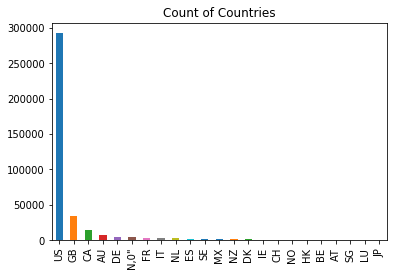

In [6]:

KickStarterData1['country'].value_counts().plot.bar()
plt.title("Count of Countries")
plt.show()

In [7]:
KickStarterDataUS = KickStarterData1[KickStarterData1['country'] == 'US']

In [8]:
print(KickStarterDataUS.nunique())

ID                  292627
name                290800
category               159
main_category           15
currency                 1
deadline              3164
goal                  7131
launched            292296
pledged              53156
state                    5
backers               3662
country                  1
usd pledged          48229
usd_pledged_real     53156
usd_goal_real         7131
dtype: int64


In [9]:
KickStarterDataUS.isnull().sum()

ID                  0
name                3
category            0
main_category       0
currency            0
deadline            0
goal                0
launched            0
pledged             0
state               0
backers             0
country             0
usd pledged         0
usd_pledged_real    0
usd_goal_real       0
dtype: int64

In [10]:
#drop NAs
KickStarterDataUS = KickStarterDataUS.dropna()

In [11]:
KickStarterDataUS.head(30)

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
1,1000003930,Greeting From Earth: ZGAC Arts Capsule For ET,Narrative Film,Film & Video,USD,2017-11-01,30000.0,2017-09-02 04:43:57,2421.00,failed,15,US,100.00,2421.00,30000.0
2,1000004038,Where is Hank?,Narrative Film,Film & Video,USD,2013-02-26,45000.0,2013-01-12 00:20:50,220.00,failed,3,US,220.00,220.00,45000.0
3,1000007540,ToshiCapital Rekordz Needs Help to Complete Album,Music,Music,USD,2012-04-16,5000.0,2012-03-17 03:24:11,1.00,failed,1,US,1.00,1.00,5000.0
4,1000011046,Community Film Project: The Art of Neighborhoo...,Film & Video,Film & Video,USD,2015-08-29,19500.0,2015-07-04 08:35:03,1283.00,canceled,14,US,1283.00,1283.00,19500.0
5,1000014025,Monarch Espresso Bar,Restaurants,Food,USD,2016-04-01,50000.0,2016-02-26 13:38:27,52375.00,successful,224,US,52375.00,52375.00,50000.0
6,1000023410,Support Solar Roasted Coffee & Green Energy! ...,Food,Food,USD,2014-12-21,1000.0,2014-12-01 18:30:44,1205.00,successful,16,US,1205.00,1205.00,1000.0
7,1000030581,Chaser Strips. Our Strips make Shots their B*tch!,Drinks,Food,USD,2016-03-17,25000.0,2016-02-01 20:05:12,453.00,failed,40,US,453.00,453.00,25000.0
8,1000034518,SPIN - Premium Retractable In-Ear Headphones w...,Product Design,Design,USD,2014-05-29,125000.0,2014-04-24 18:14:43,8233.00,canceled,58,US,8233.00,8233.00,125000.0
9,100004195,STUDIO IN THE SKY - A Documentary Feature Film...,Documentary,Film & Video,USD,2014-08-10,65000.0,2014-07-11 21:55:48,6240.57,canceled,43,US,6240.57,6240.57,65000.0
11,100005484,Lisa Lim New CD!,Indie Rock,Music,USD,2013-04-08,12500.0,2013-03-09 06:42:58,12700.00,successful,100,US,12700.00,12700.00,12500.0


In [12]:
KickStarterDataUS.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 292624 entries, 1 to 378660
Data columns (total 15 columns):
ID                  292624 non-null int64
name                292624 non-null object
category            292624 non-null object
main_category       292624 non-null object
currency            292624 non-null object
deadline            292624 non-null object
goal                292624 non-null float64
launched            292624 non-null object
pledged             292624 non-null float64
state               292624 non-null object
backers             292624 non-null int64
country             292624 non-null object
usd pledged         292624 non-null float64
usd_pledged_real    292624 non-null float64
usd_goal_real       292624 non-null float64
dtypes: float64(5), int64(2), object(8)
memory usage: 35.7+ MB


In [13]:
KickStarterDataUS.columns.tolist()

['ID',
 'name',
 'category',
 'main_category',
 'currency',
 'deadline',
 'goal',
 'launched',
 'pledged',
 'state',
 'backers',
 'country',
 'usd pledged',
 'usd_pledged_real',
 'usd_goal_real']

In [14]:
 KickStarterDataUS['goalvspledged'] = (KickStarterDataUS['pledged'] - KickStarterDataUS['goal']).round()
 KickStarterDataUS['metgoal'] = (KickStarterDataUS['pledged'] - KickStarterDataUS['goal']) > 0
 KickStarterDataUS.deadline = pd.to_datetime(KickStarterDataUS.deadline)
 KickStarterDataUS.launched = pd.to_datetime(KickStarterDataUS.launched)
  
 KickStarterDataUS['launched_diff'] = (KickStarterDataUS.launched - KickStarterDataUS.deadline)/ np.timedelta64(1, 'D')


In [15]:
 MetGoalWithState_GoalVsPledged = KickStarterDataUS.groupby(['metgoal','state'])['goalvspledged'].mean().to_frame()
 MetGoalWithState_GoalVsPledged

goalvspledged
metgoal state                    
False   canceled    -75412.406687
        failed      -59333.873151
        live        -96125.545024
        successful      -1.618873
        suspended  -282400.496124
True    canceled     12220.090517
        failed         272.000000
        live         25861.798479
        successful   13933.355930
        suspended    53118.754098

In [16]:
 StateVsLatenessInLaunch = KickStarterDataUS.groupby(['state'])['launched_diff'].mean().to_frame()
 StateVsLatenessInLaunch

,launched_diff
state,
canceled,-38.968543
failed,-34.921963
live,-38.852781
successful,-31.828179
suspended,-35.109550


In [17]:
Stats_KickStarted = KickStarterDataUS.agg({'pledged' : ['mean', 'min','max','median'], 'goal' : ['mean','min', 'max','median']})
Stats_KickStarted['goal'] = Stats_KickStarted.apply(lambda row: '$' + str(round(row['goal'] / 1,2)) + '', axis=1)
Stats_KickStarted['pledged'] = Stats_KickStarted.apply(lambda row: '$' + str(round(row['pledged'] / 1,2)) + '', axis=1)
Stats_KickStarted

,pledged,goal
mean,$9670.29,$44034.61
min,$0.0,$0.01
max,$20338986.27,$100000000.0
median,$725.0,$5250.0


In [18]:
KickStarterDataUS[KickStarterDataUS['pledged'] > 1000000]

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real,goalvspledged,metgoal,launched_diff
330,1001502333,Pimax: The World's First 8K VR Headset,Hardware,Technology,USD,2017-11-03,200000.0,2017-09-19 19:02:23,4236618.49,successful,5946,US,608194.00,4236618.49,200000.0,4036618.0,True,-44.206678
642,1003111955,QUARTZ Bottle - Water Purification in a Self-C...,Technology,Technology,USD,2017-12-07,30000.0,2017-11-07 13:57:16,1374021.00,successful,12758,US,56023.00,1374021.00,30000.0,1344021.0,True,-29.418565
3435,101767263,3Doodler: The World's First 3D Printing Pen,Hardware,Technology,USD,2013-03-25,30000.0,2013-02-19 06:08:59,2344134.67,successful,26457,US,2344134.67,2344134.67,30000.0,2314135.0,True,-33.743762
4406,1022576045,Polygons | The Flat 4-in-1 Measuring Spoon,Product Design,Design,USD,2016-11-20,10000.0,2016-10-11 17:57:34,1022120.70,successful,36863,US,135121.00,1022120.70,10000.0,1012121.0,True,-39.251690
5526,1028274367,Oculus Rift: Step Into the Game,Gaming Hardware,Games,USD,2012-09-01,250000.0,2012-08-01 16:51:23,2437429.75,successful,9522,US,2437429.75,2437429.75,250000.0,2187430.0,True,-30.297650
5810,1029803652,Barracuda: Collapsible Luggage + Tray + GPS + ...,Product Design,Design,USD,2015-05-29,20000.0,2015-04-14 11:44:34,1252222.00,successful,3397,US,1252222.00,1252222.00,20000.0,1232222.0,True,-44.510718
6665,1033978702,OUYA: A New Kind of Video Game Console,Gaming Hardware,Games,USD,2012-08-09,950000.0,2012-07-10 14:44:41,8596474.58,successful,63416,US,8596474.58,8596474.58,950000.0,7646475.0,True,-29.385637
9008,1045500705,Zombicide: Black Plague,Tabletop Games,Games,USD,2015-07-07,125000.0,2015-06-08 20:59:38,4079204.52,successful,20915,US,4079204.52,4079204.52,125000.0,3954205.0,True,-28.125255
14850,1074800880,Bloodstained: Ritual of the Night,Video Games,Games,USD,2015-06-13,500000.0,2015-05-11 18:58:41,5545991.70,successful,64867,US,5545991.70,5545991.70,500000.0,5045992.0,True,-32.209248
16387,1082939541,Sondors Electric Bike - Most Affordable eBike....,Gadgets,Technology,USD,2015-10-17,75000.0,2015-09-17 13:52:25,1354793.97,successful,1996,US,1354793.97,1354793.97,75000.0,1279794.0,True,-29.421933


In [19]:
KickStarterDataUS[KickStarterDataUS['state'].isin(['live','successful'])].groupby(['main_category'])['pledged'].mean().to_frame().sort_values(by='pledged')

,pledged
main_category,
Dance,5340.404476
Crafts,5710.643903
Theater,6407.623512
Art,6844.429589
Music,7447.404077
Publishing,9191.634907
Photography,9936.153792
Journalism,10202.706838
Comics,12080.636096


In [19]:
KickStarterDataUS.groupby(['main_category'])['goalvspledged'].mean().to_frame().sort_values(by=['goalvspledged'])

,goalvspledged
main_category,
Journalism,-99375.470621
Technology,-74492.157729
Film & Video,-73730.922998
Food,-30878.009227
Art,-29618.850247
Games,-24453.283650
Theater,-23905.197726
Publishing,-23381.541354
Design,-17346.785974


In [20]:
df_successvsunsuccess = KickStarterDataUS[~KickStarterDataUS['state'].isin(['live','successful'])].groupby(['main_category'])['state'].count().to_frame().sort_values(by='state')
df_successvsunsuccess = df_successvsunsuccess.reset_index()
df_successful = KickStarterDataUS[KickStarterDataUS['state'].isin(['live','successful'])].groupby(['main_category'])['state'].count().to_frame().sort_values(by='state')
df_successful = df_successful.reset_index()
df_successvsunsuccess  = df_successvsunsuccess.merge(df_successful,how='left', on='main_category')
df_successvsunsuccess.columns = ['main_category','unsuccessful','successful']
df_successvsunsuccess['percentSuccessful'] = df_successvsunsuccess.successful / (df_successvsunsuccess.successful + df_successvsunsuccess.unsuccessful)
df_successvsunsuccess.sort_values(by=['percentSuccessful'])

,main_category,unsuccessful,successful,percentSuccessful
11,Technology,16631,4925,0.228475
1,Journalism,2721,819,0.231356
4,Crafts,4962,1686,0.253610
6,Fashion,12316,4268,0.257356
9,Food,14462,5479,0.274761
13,Publishing,21563,10163,0.320337
5,Photography,5417,2571,0.321858
8,Design,13837,7852,0.362027
14,Film & Video,31927,19994,0.385085
10,Games,15115,9521,0.386467


/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/seaborn/categorical.py:1460: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  stat_data = remove_na(group_data)


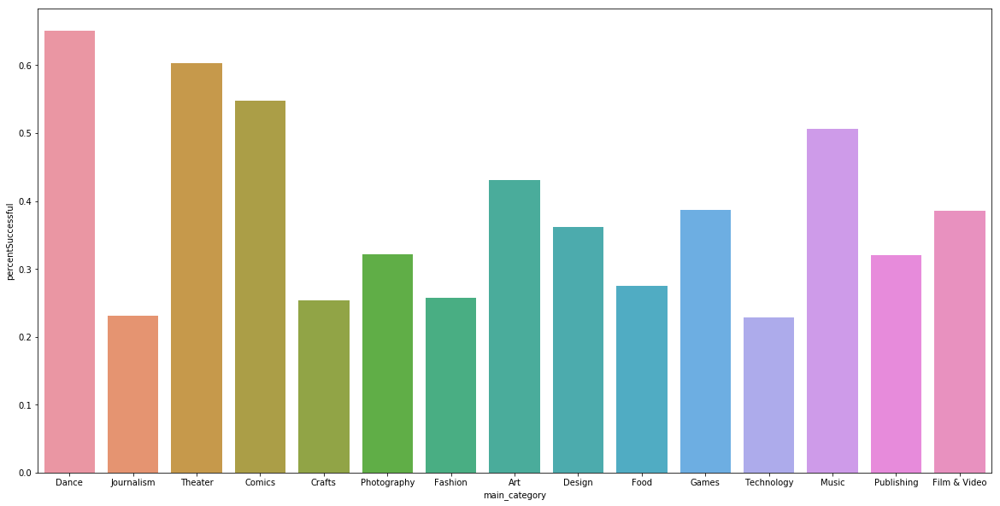

In [21]:
plt.subplots(figsize=(20,10))
sns.barplot(x="main_category",y="percentSuccessful",data = df_successvsunsuccess)

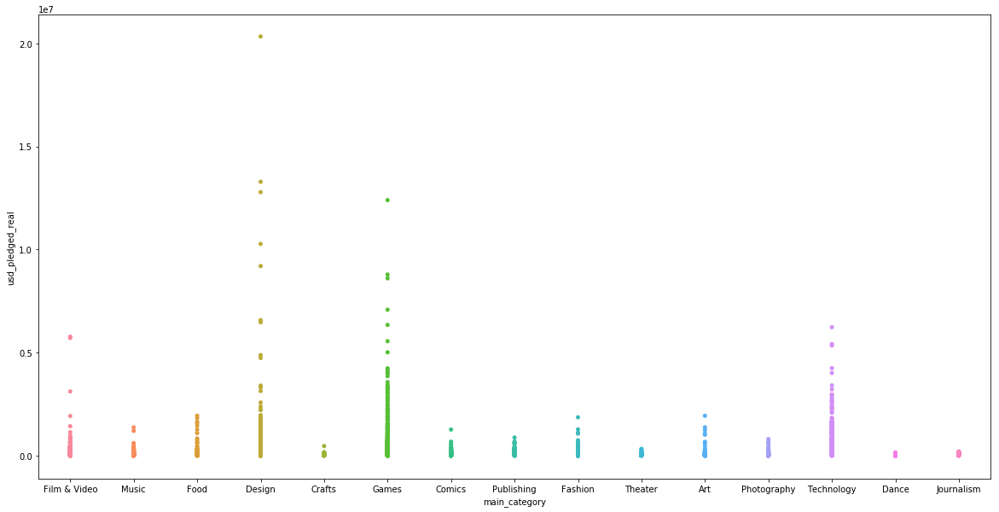

In [22]:
import matplotlib.pyplot as plt
plt.subplots(figsize=(20,10))
sns.stripplot(x="main_category", y="usd_pledged_real",data=KickStarterDataUS);

/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/seaborn/categorical.py:1460: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  stat_data = remove_na(group_data)


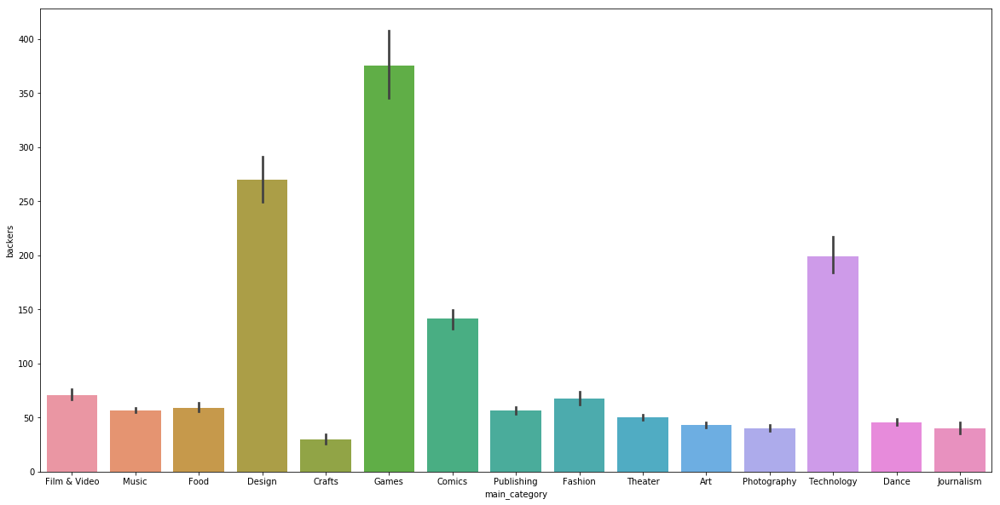

In [23]:
import matplotlib.pyplot as plt
plt.subplots(figsize=(20,10))
sns.barplot(x="main_category", y="backers",data=KickStarterDataUS);

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.tools as tls
import plotly.offline as py
from plotly.offline import init_notebook_mode, iplot, plot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import warnings
from collections import Counter
df = KickStarterDataUS
df_failed = df[df["state"] == "failed"]
df_sucess = df[df["state"] == "successful"]

#First plot
trace0 = go.Histogram(
    x= np.log(df.usd_goal_real + 1).head(100000),
    histnorm='probability', showlegend=False,
    xbins=dict(
        start=-5.0,
        end=19.0,
        size=1),
    autobiny=True)

#Second plot
trace1 = go.Histogram(
    x = np.log(df.usd_pledged_real + 1).head(100000),
    histnorm='probability', showlegend=False,
    xbins=dict(
        start=-1.0,
        end=17.0,
        size=1))

# Add histogram data
x1 = np.log(df_failed['usd_goal_real']+1).head(100000)
x2 = np.log(df_sucess["usd_goal_real"]+1).head(100000)

trace3 = go.Histogram(
    x=x1,
    opacity=0.60, nbinsx=30, name='Goals Failed', histnorm='probability'
)
trace4 = go.Histogram(
    x=x2,
    opacity=0.60, nbinsx=30, name='Goals Sucessful', histnorm='probability'
)


data = [trace0, trace1, trace3, trace4]
layout = go.Layout(barmode='overlay')

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[ [{'colspan': 2}, None], [{}, {}]],
                          subplot_titles=('Failed and Sucessful Projects',
                                          'Goal','Pledged'))

#setting the figs
fig.append_trace(trace0, 2, 1)
fig.append_trace(trace1, 2, 2)
fig.append_trace(trace3, 1, 1)
fig.append_trace(trace4, 1, 1)

fig['layout'].update(title="Distribuitions",
                     height=500, width=900, barmode='overlay')
iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1           -      ]
[ (2,1) x2,y2 ]  [ (2,2) x3,y3 ]



In [26]:
main_cats = df["main_category"].value_counts()
main_cats_failed = df[df["state"] == "failed"]["main_category"].value_counts()
main_cats_sucess = df[df["state"] == "successful"]["main_category"].value_counts()

In [27]:
#First plot
trace0 = go.Bar(
    x=main_cats_failed.index,
    y=main_cats_failed.values,
    name="Failed Category's"
)
#Second plot
trace1 = go.Bar(
    x=main_cats_sucess.index,
    y=main_cats_sucess.values,
    name="Sucess Category's"
)
#Third plot
trace2 = go.Bar(
    x=main_cats.index,
    y=main_cats.values,
    name="All Category's Distribuition"
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Failed','Sucessful', "General Category's"))

#setting the figs
fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)

fig['layout'].update(showlegend=True, title="Main Category's Distribuition",bargap=0.05)
iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]
[ (2,1) x3,y3           -      ]



In [90]:
# Let's Boil down these columns to the most impactful ,numeric columns.
FinalKickStarterData = KickStarterDataUS
#FinalKickStarterData.head(20)
FinalKickStarterData = FinalKickStarterData.drop('currency',1)
FinalKickStarterData = FinalKickStarterData.drop('launched',1)
FinalKickStarterData = FinalKickStarterData.drop('country',1)
FinalKickStarterData = FinalKickStarterData.drop('usd_pledged_real',1)
FinalKickStarterData = FinalKickStarterData.drop('usd pledged',1)
FinalKickStarterData = FinalKickStarterData.drop('usd_goal_real',1)
FinalKickStarterData = FinalKickStarterData.drop('name',1)
FinalKickStarterData = FinalKickStarterData.drop('deadline',1)
FinalKickStarterData = FinalKickStarterData.drop('ID',1)
FinalKickStarterData['binary_state'] = np.where(FinalKickStarterData['state'] == 'successful', 1, 0)
FinalKickStarterData['binary_met_goal'] = np.where(FinalKickStarterData['metgoal'] == True, 1, 0)
FinalKickStarterData = FinalKickStarterData.drop('state',1)
FinalKickStarterData = FinalKickStarterData.drop('metgoal',1)
FinalKickStarterData_ForLinear = FinalKickStarterData
FinalKickStarterData = FinalKickStarterData.drop('goalvspledged',1)
FinalKickStarterData = FinalKickStarterData.drop('binary_met_goal',1)
FinalKickStarterData_ForLinear = FinalKickStarterData_ForLinear.drop('binary_met_goal',1)
FinalKickStarterData = FinalKickStarterData.drop('category',1)
FinalKickStarterData_ForLinear = FinalKickStarterData_ForLinear.drop('category',1)
FinalKickStarterData_ForLinear = FinalKickStarterData_ForLinear.drop('pledged',1)

FinalKickStarterData.head(20)


,main_category,goal,pledged,backers,launched_diff,binary_state
1,Film & Video,30000.0,2421.00,15,-59.802813,0
2,Film & Video,45000.0,220.00,3,-44.985532,0
3,Music,5000.0,1.00,1,-29.858206,0
4,Film & Video,19500.0,1283.00,14,-55.642326,0
5,Food,50000.0,52375.00,224,-34.431632,1
6,Food,1000.0,1205.00,16,-19.228657,1
7,Food,25000.0,453.00,40,-44.163056,0
8,Design,125000.0,8233.00,58,-34.239780,0
9,Film & Video,65000.0,6240.57,43,-29.086250,0
11,Music,12500.0,12700.00,100,-29.720162,1


In [91]:
#FinalKickStarterData = pd.get_dummies(FinalKickStarterData, columns = ['category'])
FinalKickStarterData = pd.get_dummies(FinalKickStarterData, columns = ['main_category'])
FinalKickStarterData_ForLinear = pd.get_dummies(FinalKickStarterData_ForLinear, columns = ['main_category'])
FinalKickStarterDataCopy = FinalKickStarterData
Y_LogisticRegressionTest = FinalKickStarterData['binary_state']
FinalKickStarterData=FinalKickStarterData.drop('binary_state',1)

In [92]:
X_train, X_test, Y_train, Y_test = train_test_split(
    FinalKickStarterData,
    Y_LogisticRegressionTest, 
    test_size = 0.25,
    random_state=42
)

print(X_train.shape, Y_train.shape)
print(X_test.shape, Y_test.shape)

(219468, 19) (219468,)
(73156, 19) (73156,)


In [93]:
logreg = LogisticRegression()
logreg.fit(X_train, Y_train)

acc_log = round(logreg.score(X_test, Y_test), 100*2)
acc_log

dfTest = pd.DataFrame(FinalKickStarterData.columns.values)




import sklearn.feature_selection as fs
model_accuracy = fs.f_regression(X_test, Y_test, True)
print(model_accuracy)

dfTest['Coefficient'] = logreg.coef_[0]
dfTest['PValue'] = model_accuracy[1]

#print(len(logreg.coef_))
#print(logreg.coef_)
dfTest.columns = ['Component', 'Coefficient','PValue']
dfTest.sort_values(by=['Coefficient'],ascending=False).head(30)
#import statsmodels.api as sm
#import statsmodels.formula.api as smf
#logit_model=sm.Logit(Y_LogisticRegressionTest,FinalKickStarterData)
#result=logit_model.fit()
#print(result.summary())





(array([  3.86133193e+01,   1.47295027e+03,   1.71927832e+03,
         1.20939370e+03,   4.01766597e+01,   2.57434863e+02,
         1.25375553e+02,   2.43984161e+02,   4.74415616e+00,
         2.87038045e+02,   6.78073637e+00,   2.30783573e+02,
         9.49111342e-01,   8.54014704e+01,   8.99089801e+02,
         2.16403067e+01,   1.44152794e+02,   5.86726049e+02,
         5.22750350e+02]), array([  5.19425344e-010,   4.49011800e-319,   0.00000000e+000,
         7.84384776e-263,   2.33349904e-010,   7.80830749e-058,
         4.44789359e-029,   6.52959206e-055,   2.94011507e-002,
         2.91583862e-064,   9.21654844e-003,   4.83086836e-052,
         3.29948822e-001,   2.49825986e-020,   2.41186107e-196,
         3.29442289e-006,   3.53518234e-033,   4.17815884e-129,
         2.71250929e-115]))


,Component,Coefficient,PValue
2,backers,0.016923,0.000000e+00
1,pledged,0.000944,4.490118e-319
14,main_category_Music,0.000235,2.411861e-196
10,main_category_Film & Video,0.000166,9.216548e-03
3,launched_diff,0.000160,7.843848e-263
18,main_category_Theater,0.000104,2.712509e-115
4,main_category_Art,0.000051,2.333499e-10
7,main_category_Dance,0.000042,6.529592e-55
5,main_category_Comics,0.000024,7.808307e-58
13,main_category_Journalism,-0.000014,2.498260e-20


In [94]:
from sklearn.metrics import classification_report
print(acc_log)
predictions=logreg.predict(X_test)
print(classification_report(Y_test,predictions))

0.989679588824
             precision    recall  f1-score   support

          0       1.00      0.98      0.99     45836
          1       0.97      1.00      0.99     27320

avg / total       0.99      0.99      0.99     73156



In [95]:
Y_LinearRegressionTest = FinalKickStarterData_ForLinear['goalvspledged']
FinalKickStarterData_ForLinear=FinalKickStarterData_ForLinear.drop('goalvspledged',1)

In [96]:
FinalKickStarterData_ForLinear.head(10)

,goal,backers,launched_diff,binary_state,main_category_Art,main_category_Comics,main_category_Crafts,main_category_Dance,main_category_Design,main_category_Fashion,main_category_Film & Video,main_category_Food,main_category_Games,main_category_Journalism,main_category_Music,main_category_Photography,main_category_Publishing,main_category_Technology,main_category_Theater
1,30000.0,15,-59.802813,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2,45000.0,3,-44.985532,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
3,5000.0,1,-29.858206,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4,19500.0,14,-55.642326,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
5,50000.0,224,-34.431632,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
6,1000.0,16,-19.228657,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
7,25000.0,40,-44.163056,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
8,125000.0,58,-34.239780,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,65000.0,43,-29.086250,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
11,12500.0,100,-29.720162,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [104]:
Xr_train, Xr_test, Yr_train, Yr_test = train_test_split(
    FinalKickStarterData_ForLinear,
    Y_LinearRegressionTest, 
    test_size = 0.25,
    random_state=42
)

print(Xr_train.shape, Yr_train.shape)
print(Xr_test.shape, Yr_test.shape)


lm = linear_model.LinearRegression()
model = lm.fit(Xr_train,Yr_train)



(219468, 19) (219468,)
(73156, 19) (73156,)


In [105]:
FinalKickStarterData_ForLinear[FinalKickStarterData_ForLinear['goal'] == 0].count()
FinalKickStarterData_ForLinear.head(20)

,goal,backers,launched_diff,binary_state,main_category_Art,main_category_Comics,main_category_Crafts,main_category_Dance,main_category_Design,main_category_Fashion,main_category_Film & Video,main_category_Food,main_category_Games,main_category_Journalism,main_category_Music,main_category_Photography,main_category_Publishing,main_category_Technology,main_category_Theater
1,30000.0,15,-59.802813,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2,45000.0,3,-44.985532,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
3,5000.0,1,-29.858206,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4,19500.0,14,-55.642326,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
5,50000.0,224,-34.431632,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
6,1000.0,16,-19.228657,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
7,25000.0,40,-44.163056,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
8,125000.0,58,-34.239780,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9,65000.0,43,-29.086250,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
11,12500.0,100,-29.720162,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0


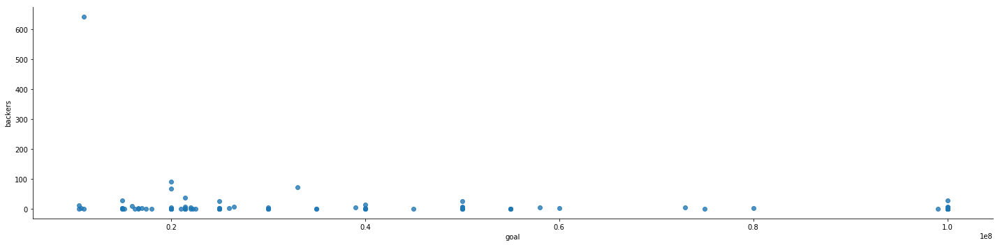

In [106]:
#sns.regplot("backers", "goal", data=FinalKickStarterData_ForLinear)
#import matplotlib.pyplot as plt
#plt.subplots(figsize=(20,10))

sns.lmplot("goal", "backers", data=KickStarterDataUS[KickStarterDataUS['goal'] > 10000000], size=5, aspect=4, fit_reg=False, scatter=True)


In [107]:
predictions = lm.predict(Xr_test)
print(predictions)
len(predictions)
print ( model.coef_)

acc_linear = round(lm.score(Xr_test, Yr_test), 100*2)
acc_linear

dfTest = pd.DataFrame(FinalKickStarterData_ForLinear.columns.values)
dfTest.head(30)



import sklearn.feature_selection as fs
model_accuracy = fs.f_regression(Xr_test, Yr_test, True)
print(model_accuracy)

dfTest['Coefficient'] = lm.coef_
dfTest['PValue'] = model_accuracy[1]

dfTest.columns = ['Component', 'Coefficient','PValue']
dfTest.sort_values(by=['Coefficient'],ascending=False).head(30)



[ -4628.54244343  -4885.02434329  -2928.82672811 ...,  -8524.38812315
 -19394.22754338  -9366.7081398 ]
[ -9.99821163e-01   7.71490239e+01  -1.95351864e+00   3.19046046e+03
  -8.70925869e+02  -5.19103148e+03  -9.22091313e+02  -1.46832204e+03
   6.08948510e+03   6.23733608e+02   4.40393926e+02   7.41337467e+02
  -4.39722356e+03  -5.15249449e+02  -1.41891596e+03  -1.23409877e+02
  -1.50079370e+03   9.56691630e+03  -1.05390315e+03]
(array([  1.42356143e+07,   1.76653767e+02,   2.60431782e+01,
         7.95827979e+01,   1.50588246e+00,   6.71492481e-01,
         7.89460990e-01,   5.25951865e-01,   7.36380510e-01,
         1.84704861e+00,   1.30143622e+01,   1.59968758e-01,
         2.26620463e+00,   1.12569010e+00,   6.19790637e+00,
         9.26810441e-01,   4.94961894e+00,   2.75799809e+00,
         4.94338550e-01]), array([  0.00000000e+00,   2.90295244e-40,   3.34699693e-07,
         4.72800423e-19,   2.19772412e-01,   4.12534413e-01,
         3.74266082e-01,   4.68316089e-01,   3.9082

,Component,Coefficient,PValue
17,main_category_Technology,9566.916295,9.677355e-02
8,main_category_Design,6089.485104,3.908256e-01
3,binary_state,3190.460461,4.728004e-19
11,main_category_Food,741.337467,6.891864e-01
9,main_category_Fashion,623.733608,1.741312e-01
10,main_category_Film & Video,440.393926,3.093168e-04
1,backers,77.149024,2.902952e-40
0,goal,-0.999821,0.000000e+00
2,launched_diff,-1.953519,3.346997e-07
15,main_category_Photography,-123.409877,3.356963e-01


In [89]:
models = pd.DataFrame({
    'Model': ['Logistic Regression',   
              'Linear Regression'
              
              ],
    'Score': [acc_log,  
              acc_linear
             
            ]})
models.sort_values(by='Score', ascending=False)


,Model,Score
1,Linear Regression,1.00000
0,Logistic Regression,0.98968
